# VQA-FineTuned Model: VQA-based Curiosity Heatmap Model

This notebook fine-tunes a VQA-style BLIP model to output a 14×14 curiosity heatmap instead of text answers.

- Input: RGB image (224×224) + fixed curiosity question
- Output: 14×14 heatmap of question-provoking regions (ViT patches)
- Supervision: bounding-box annotations converted to soft heatmaps

Sections:
1. Dependencies and imports
2. Data loading and dataset
3. Model (BLIP encoders + fusion → heatmap decoder)
4. Losses (MSE + Ranking + TV Smoothness)
5. Training (freeze schedule, checkpointing)
6. Evaluation metrics and visualization
7. Run training and validation


In [13]:
# Install dependencies (safe if already installed)
%pip install -q transformers torch torchvision pillow opencv-python matplotlib numpy scikit-learn scipy tqdm scikit-image


Note: you may need to restart the kernel to use updated packages.


In [14]:
# Imports
import os
import json
from pathlib import Path
from typing import List, Dict, Tuple

import numpy as np
import cv2
from PIL import Image

import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
from torch.utils.data import Dataset, DataLoader

import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from tqdm import tqdm

from transformers import BlipProcessor, BlipModel

import warnings
warnings.filterwarnings("ignore")

print(" Imports loaded")


 Imports loaded


In [15]:
# Data loading utilities

def load_json_any_encoding(path: str) -> Dict:
    """Load JSON file with multiple encoding attempts."""
    encodings = [
        "utf-8", "utf-8-sig",
        "utf-16", "utf-16-le", "utf-16-be",
        "utf-32", "utf-32-le", "utf-32-be",
        "cp1252", "latin1",
    ]
    raw = Path(path).read_bytes()
    for enc in encodings:
        try:
            return json.loads(raw.decode(enc))
        except Exception:
            continue
    raise ValueError(f"Failed to decode JSON: {path}")


def load_all_annotations() -> List[Dict]:
    """Load annotations from Domain_1_Images ... Domain_5_Images."""
    all_data: List[Dict] = []
    domains = [f"Domain_{i}_Images" for i in range(1, 6)]

    for domain_idx, domain_dir in enumerate(domains):
        ann_path = Path(domain_dir) / "annotations.json"
        if not ann_path.exists():
            continue
        try:
            data = load_json_any_encoding(str(ann_path))
            key = (
                "annotations"
                if "annotations" in data
                else ("images" if "images" in data else None)
            )
            if key is None:
                continue

            items = data[key]
            for img_entry in items:
                img_name = img_entry["name"]
                img_path = Path(domain_dir) / img_name
                if not img_path.exists():
                    continue

                for bbox in img_entry.get("annotations", []):
                    attrs = bbox.get("attributes", {})
                    question = (attrs.get("question", "") or "").strip()
                    all_data.append(
                        {
                            "image_path": str(img_path),
                            "image_name": img_name,
                            "domain_id": domain_idx,  # 0..4
                            "domain_name": domain_dir,
                            "question": question,
                            "question_type": attrs.get("question_type", "why"),
                            "curiosity_score": float(attrs.get("curiosity_score", 0) or 0.0),
                            "bbox": {
                                "xtl": bbox.get("xtl", 0),
                                "ytl": bbox.get("ytl", 0),
                                "xbr": bbox.get("xbr", 0),
                                "ybr": bbox.get("ybr", 0),
                            },
                        }
                    )
        except Exception as e:
            print(f"⚠ Error loading {domain_dir}: {e}")
            continue

    return all_data

print(" Data loading functions ready")


 Data loading functions ready


In [16]:
# Dataset: CuriosityVQADataset
# Includes hybrid GT (Gaussian-attended saliency) like in heatmap notebooks

def _spectral_residual_saliency(image_path: str, small_size: int = 256, blur_sigma: int = 3) -> np.ndarray:
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY).astype(np.float32)
    h, w = gray.shape
    g_small = cv2.resize(gray, (small_size, small_size))
    F = np.fft.fft2(g_small)
    A = np.abs(F); P = np.angle(F)
    logA = np.log(A + 1e-8)
    logA_sm = cv2.blur(logA, (3, 3))
    SR = logA - logA_sm
    recon = np.fft.ifft2(np.exp(SR + 1j * P))
    S = np.abs(recon).astype(np.float32)
    S = cv2.GaussianBlur(S, (0, 0), blur_sigma)
    S = cv2.resize(S, (w, h))
    S = (S - S.min()) / (S.max() - S.min() + 1e-8)
    return S


def _gaussian_heatmap(width: int, height: int, annotations: List[Dict], sigma_divisor: float = 4.0,
                      score_scaling: str = 'quadratic', combine: str = 'max', post_blur: int = 1) -> np.ndarray:
    H = np.zeros((height, width), dtype=np.float32)
    for ann in annotations:
        xtl, ytl = float(ann['xtl']), float(ann['ytl'])
        xbr, ybr = float(ann['xbr']), float(ann['ybr'])
        score = float(ann.get('score', ann.get('attributes', {}).get('curiosity_score', 0.0)))
        cx, cy = (xtl + xbr) / 2.0, (ytl + ybr) / 2.0
        sx, sy = max((xbr - xtl) / sigma_divisor, 1e-3), max((ybr - ytl) / sigma_divisor, 1e-3)
        if score_scaling == 'linear':
            amp = score / 5.0
        elif score_scaling == 'quadratic':
            amp = (score / 5.0) ** 1.5
        else:
            amp = (np.exp(score) - 1.0) / (np.exp(5.0) - 1.0)
        x0 = int(max(0, cx - 3 * sx)); x1 = int(min(width,  cx + 3 * sx))
        y0 = int(max(0, cy - 3 * sy)); y1 = int(min(height, cy + 3 * sy))
        yy, xx = np.ogrid[y0:y1, x0:x1]
        g = amp * np.exp(-(((xx - cx) ** 2) / (2 * sx ** 2) + ((yy - cy) ** 2) / (2 * sy ** 2)))
        if combine == 'max':
            H[y0:y1, x0:x1] = np.maximum(H[y0:y1, x0:x1], g)
        else:
            H[y0:y1, x0:x1] += g
    if H.max() > 0:
        H = (H - H.min()) / (H.max() - H.min())
    if post_blur > 0:
        H = cv2.GaussianBlur(H, (0, 0), post_blur)
        if H.max() > 0:
            H = (H - H.min()) / (H.max() - H.min())
    return H


def _soft_box_mask(width: int, height: int, annotations: List[Dict], soft_sigma: int = 8) -> np.ndarray:
    M = np.zeros((height, width), dtype=np.float32)
    for ann in annotations:
        xtl, ytl = int(ann['xtl']), int(ann['ytl'])
        xbr, ybr = int(ann['xbr']), int(ann['ybr'])
        M[ytl:ybr, xtl:xbr] = 1.0
    if soft_sigma > 0:
        M = cv2.GaussianBlur(M, (0, 0), soft_sigma)
        if M.max() > 0:
            M = (M - M.min()) / (M.max() - M.min())
    return M


def _build_hybrid_heatmap(image_path: str, width: int, height: int, bbox: Dict, curiosity_score: float,
                          alpha: float = 0.8, beta: float = 0.2, lambda_out: float = 0.15,
                          boost: float = 2.0, soft_sigma: int = 8, sal_small_size: int = 256) -> np.ndarray:
    # Construct annotation list compatible with helpers
    anns = [{
        'xtl': float(bbox['xtl']), 'ytl': float(bbox['ytl']),
        'xbr': float(bbox['xbr']), 'ybr': float(bbox['ybr']),
        'attributes': {'curiosity_score': float(curiosity_score)}
    }]
    G = _gaussian_heatmap(width, height, anns, sigma_divisor=4.0, score_scaling='quadratic', combine='max', post_blur=1)
    S = _spectral_residual_saliency(image_path, small_size=sal_small_size, blur_sigma=3)
    M = _soft_box_mask(width, height, anns, soft_sigma=soft_sigma)
    W = lambda_out + (boost - lambda_out) * M
    S_att = W * S
    C = alpha * G + beta * S_att
    if C.max() > 0:
        C = (C - C.min()) / (C.max() - C.min())
    return C


class CuriosityVQADataset(Dataset):
    def __init__(
        self,
        annotations: List[Dict],
        processor: BlipProcessor,
        image_size: int = 224,
        patch_size: int = 14,
        question_text: str = "Which parts of the image are likely to provoke human curiosity?",
        use_gaussian_labels: bool = True,
        gaussian_sigma: float = 1.0,
        use_hybrid_gt: bool = True,
        alpha: float = 0.8,
        beta: float = 0.2,
        lambda_out: float = 0.15,
        boost: float = 2.0,
        soft_sigma: int = 8,
        sal_small_size: int = 256,
    ):
        self.annotations = annotations
        self.processor = processor
        self.image_size = image_size
        self.patch_size = patch_size
        self.question_text = question_text
        self.use_gaussian_labels = use_gaussian_labels
        self.gaussian_sigma = gaussian_sigma
        self.use_hybrid_gt = use_hybrid_gt
        self.alpha = alpha
        self.beta = beta
        self.lambda_out = lambda_out
        self.boost = boost
        self.soft_sigma = soft_sigma
        self.sal_small_size = sal_small_size

    def __len__(self) -> int:
        return len(self.annotations)

    @staticmethod
    def _bbox_to_patch_coords(
        xtl: float, ytl: float, xbr: float, ybr: float,
        orig_w: int, orig_h: int, image_size: int, patch_size: int
    ) -> Tuple[int, int, int, int]:
        scale_x = image_size / float(orig_w)
        scale_y = image_size / float(orig_h)
        xtl_s = int(xtl * scale_x)
        ytl_s = int(ytl * scale_y)
        xbr_s = int(xbr * scale_x)
        ybr_s = int(ybr * scale_y)

        patch_w = image_size / float(patch_size)
        px1 = int(xtl_s / patch_w)
        py1 = int(ytl_s / patch_w)
        px2 = int(xbr_s / patch_w)
        py2 = int(ybr_s / patch_w)

        px1 = max(0, min(px1, patch_size - 1))
        py1 = max(0, min(py1, patch_size - 1))
        px2 = max(0, min(px2, patch_size - 1))
        py2 = max(0, min(py2, patch_size - 1))
        return px1, py1, px2, py2

    def _make_heatmap(self, bbox_patch: Dict[str, int], score01: float) -> Tuple[torch.Tensor, torch.Tensor]:
        H = self.patch_size
        heatmap = torch.zeros(H, H, dtype=torch.float32)
        mask = torch.zeros(H, H, dtype=torch.float32)
        px1, py1, px2, py2 = (
            bbox_patch["xtl"], bbox_patch["ytl"], bbox_patch["xbr"], bbox_patch["ybr"],
        )
        mask[py1:py2 + 1, px1:px2 + 1] = 1.0
        heatmap[py1:py2 + 1, px1:px2 + 1] = score01

        if self.use_gaussian_labels and mask.sum() > 0:
            hm_np = heatmap.numpy()
            hm_np = cv2.GaussianBlur(hm_np, ksize=(0, 0), sigmaX=self.gaussian_sigma)
            heatmap = torch.from_numpy(hm_np.astype(np.float32))
        return heatmap, mask

    def __getitem__(self, idx: int) -> Dict:
        ann = self.annotations[idx]
        image_path = ann["image_path"]
        image = Image.open(image_path).convert("RGB")
        orig_w, orig_h = image.size

        # Resize to model input size (BLIP expects 224 typically)
        image_resized = image.resize((self.image_size, self.image_size), Image.BILINEAR)
        img_tensor = torch.from_numpy(np.array(image_resized)).permute(2, 0, 1).float() / 255.0

        bbox = ann["bbox"]
        px1, py1, px2, py2 = self._bbox_to_patch_coords(
            bbox["xtl"], bbox["ytl"], bbox["xbr"], bbox["ybr"], orig_w, orig_h, self.image_size, self.patch_size
        )
        bbox_patch = {"xtl": px1, "ytl": py1, "xbr": px2, "ybr": py2}

        # Hybrid GT heatmap (C) at original resolution, then downsample to 14×14
        if self.use_hybrid_gt:
            C = _build_hybrid_heatmap(
                image_path=image_path,
                width=orig_w,
                height=orig_h,
                bbox=bbox,
                curiosity_score=float(ann.get("curiosity_score", 0.0)),
                alpha=self.alpha,
                beta=self.beta,
                lambda_out=self.lambda_out,
                boost=self.boost,
                soft_sigma=self.soft_sigma,
                sal_small_size=self.sal_small_size,
            )
            C_14 = cv2.resize(C, (self.patch_size, self.patch_size), interpolation=cv2.INTER_LINEAR)
            target_map = torch.from_numpy(C_14.astype(np.float32))
            # Keep bbox-based mask for loss components
            patch_mask = torch.zeros(self.patch_size, self.patch_size, dtype=torch.float32)
            patch_mask[py1:py2 + 1, px1:px2 + 1] = 1.0
        else:
            # Fallback: simple bbox fill (previous behavior)
            score01 = float(ann.get("curiosity_score", 0.0)) / 5.0
            target_map, patch_mask = self._make_heatmap(bbox_patch, score01)

        # Tokenize fixed curiosity question
        text_inputs = self.processor.tokenizer(
            self.question_text,
            padding="max_length",
            truncation=True,
            max_length=32,
            return_tensors="pt",
        )

        return {
            "image": img_tensor,  # [3, 224, 224]
            "input_ids": text_inputs.input_ids.squeeze(0),
            "attention_mask": text_inputs.attention_mask.squeeze(0),
            "target_map": target_map,            # [14, 14]
            "patch_mask": patch_mask,            # [14, 14]
            "domain_id": torch.tensor(ann["domain_id"], dtype=torch.long),
            "question_type": ann.get("question_type", "why"),
            "original_size": (orig_w, orig_h),
            "bbox_original": bbox,
            "image_path": image_path,
        }

print(" Dataset ready")


 Dataset ready


In [17]:
# Model: VQACuriosityNet (BLIP encoders + fusion → heatmap)

class VQACuriosityNet(nn.Module):
    def __init__(
        self,
        hidden_dim: int = 768,
        patch_size: int = 14,
        num_question_types: int = 4,  # why/what/how/anomaly
        freeze_vision: bool = True,
        freeze_text: bool = True,
    ):
        super().__init__()
        self.patch_size = patch_size
        self.hidden_dim = hidden_dim

        # Load BLIP base model (vision + text encoders)
        print("Loading BLIP base model...")
        self.blip = BlipModel.from_pretrained("Salesforce/blip-image-captioning-base")
        self.vision = self.blip.vision_model
        self.text = self.blip.text_model

        # Optional freezing
        if freeze_vision:
            for p in self.vision.parameters():
                p.requires_grad = False
            print("Vision encoder frozen")
        if freeze_text:
            for p in self.text.parameters():
                p.requires_grad = False
            print("Text encoder frozen")

        # Question type embedding (optional conditioning)
        self.question_type_to_id = {"why": 0, "what": 1, "how": 2, "anomaly": 3}
        self.qtype_embedding = nn.Embedding(num_question_types, 128)
        self.qtype_proj = nn.Linear(128, hidden_dim)

        # Fusion: simple cross-attention (patches query, text keys/values)
        self.q_proj = nn.Linear(hidden_dim, hidden_dim)
        self.k_proj = nn.Linear(hidden_dim, hidden_dim)
        self.v_proj = nn.Linear(hidden_dim, hidden_dim)
        self.attn_scale = hidden_dim ** 0.5
        self.fusion_ln = nn.LayerNorm(hidden_dim)

        # Decoder: patch-wise MLP → 1 score per patch (196 → 14×14)
        self.decoder = nn.Sequential(
            nn.LayerNorm(hidden_dim),
            nn.Linear(hidden_dim, hidden_dim),
            nn.GELU(),
            nn.Dropout(0.1),
            nn.Linear(hidden_dim, 1),
        )

    def encode_image(self, images: torch.Tensor) -> torch.Tensor:
        # images: [B, 3, 224, 224] in [0,1]
        out = self.vision(pixel_values=images)
        feats = out.last_hidden_state  # [B, 197, D]
        patches = feats[:, 1:, :]      # drop CLS → [B, 196, D]
        return patches

    def encode_text(self, input_ids: torch.Tensor, attention_mask: torch.Tensor) -> torch.Tensor:
        out = self.text(input_ids=input_ids, attention_mask=attention_mask)
        text_feats = out.last_hidden_state  # [B, L, D]
        return text_feats

    def forward(
        self,
        images: torch.Tensor,
        input_ids: torch.Tensor,
        attention_mask: torch.Tensor,
        question_types: List[str] = None,
    ) -> torch.Tensor:
        B = images.size(0)

        # Encode modalities
        patch_feats = self.encode_image(images)              # [B, 196, D]
        text_feats = self.encode_text(input_ids, attention_mask)  # [B, L, D]

        # Project to Q/K/V
        Q = self.q_proj(patch_feats)                         # [B, 196, D]
        K = self.k_proj(text_feats)                          # [B, L, D]
        V = self.v_proj(text_feats)                          # [B, L, D]

        # Scaled dot-product attention: patches attend to text tokens
        attn_logits = torch.matmul(Q, K.transpose(1, 2)) / self.attn_scale  # [B, 196, L]
        attn_weights = torch.softmax(attn_logits, dim=-1)                   # [B, 196, L]
        attended_text = torch.matmul(attn_weights, V)                        # [B, 196, D]

        # Add question-type conditioning (optional)
        if question_types is not None:
            qtype_ids = torch.tensor(
                [self.question_type_to_id.get(qt, 0) for qt in question_types],
                device=images.device,
                dtype=torch.long,
            )
            qtype_emb = self.qtype_proj(self.qtype_embedding(qtype_ids))  # [B, D]
            qtype_emb = qtype_emb.unsqueeze(1).expand(-1, patch_feats.size(1), -1)  # [B, 196, D]
        else:
            qtype_emb = torch.zeros_like(patch_feats)

        # Fuse and decode scores
        fused = self.fusion_ln(patch_feats + attended_text + qtype_emb)    # [B, 196, D]
        scores = self.decoder(fused).squeeze(-1)                            # [B, 196]
        heatmaps = scores.view(B, self.patch_size, self.patch_size)         # [B, 14, 14]
        return heatmaps

print(" Model class ready")


 Model class ready


In [18]:
# Loss functions: MSE + ranking + TV smoothness

class HeatmapLoss(nn.Module):
    def __init__(self, lambda_rank: float = 0.5, lambda_tv: float = 0.1):
        super().__init__()
        self.lambda_rank = lambda_rank
        self.lambda_tv = lambda_tv
        self.mse = nn.MSELoss(reduction="none")

    @staticmethod
    def tv_loss(x: torch.Tensor) -> torch.Tensor:
        # Total Variation loss for smoothness, x: [B, H, W]
        dh = torch.abs(x[:, 1:, :] - x[:, :-1, :]).mean()
        dw = torch.abs(x[:, :, 1:] - x[:, :, :-1]).mean()
        return dh + dw

    def forward(self, pred: torch.Tensor, target: torch.Tensor, patch_mask: torch.Tensor) -> Tuple[torch.Tensor, Dict[str, float]]:
        # pred/target: [B, 14, 14], patch_mask: [B, 14, 14]
        masked_pred = pred * patch_mask
        masked_tgt = target * patch_mask

        # Avoid div by zero
        denom = patch_mask.sum() + 1e-8
        mse_map = self.mse(masked_pred, masked_tgt)
        mse_loss = mse_map.sum() / denom

        # Ranking loss (inside vs outside)
        inside = patch_mask > 0.5
        outside = patch_mask < 0.5
        if inside.any() and outside.any():
            inside_scores = pred[inside].mean()
            outside_scores = pred[outside].mean()
            margin = 0.5
            rank_loss = F.relu(margin - (inside_scores - outside_scores))
        else:
            rank_loss = torch.tensor(0.0, device=pred.device)

        # TV smoothness loss
        tv = self.tv_loss(pred)

        total = mse_loss + self.lambda_rank * rank_loss + self.lambda_tv * tv
        return total, {
            "mse": float(mse_loss.item()),
            "rank": float(rank_loss.item()),
            "tv": float(tv.item()),
            "total": float(total.item()),
        }

print(" Loss functions ready")


 Loss functions ready


In [19]:
# Setup: device, data split, dataloaders

device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

print("\nLoading annotations...")
all_annotations = load_all_annotations()
print(f" Loaded {len(all_annotations)} annotations")

train_ann, val_ann = train_test_split(all_annotations, test_size=0.2, random_state=42)
print(f"Train: {len(train_ann)}, Val: {len(val_ann)}")

processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")

train_dataset = CuriosityVQADataset(train_ann, processor=processor, image_size=224, patch_size=14)
val_dataset = CuriosityVQADataset(val_ann, processor=processor, image_size=224, patch_size=14)

batch_size = 6
train_loader = DataLoader(train_dataset, batch_size=batch_size, shuffle=True, num_workers=0)
val_loader = DataLoader(val_dataset, batch_size=batch_size, shuffle=False, num_workers=0)

print(" Dataloaders ready")


Using device: cpu

Loading annotations...
 Loaded 219 annotations
Train: 175, Val: 44
 Dataloaders ready


In [ ]:
# Train/validate helpers and training loop with freeze/unfreeze schedule

def train_one_epoch(model, loader, criterion, optimizer, device):
    model.train()
    total = 0.0
    hist = {"mse": [], "rank": [], "tv": [], "total": []}
    pbar = tqdm(loader, desc="Training")
    for batch in pbar:
        images = batch["image"].to(device)
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        targets = batch["target_map"].to(device)
        masks = batch["patch_mask"].to(device)
        qtypes = batch["question_type"]

        optimizer.zero_grad()
        preds = model(images, input_ids, attention_mask, qtypes)
        loss, metrics = criterion(preds, targets, masks)
        loss.backward()
        torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
        optimizer.step()

        total += loss.item()
        for k in hist:
            hist[k].append(metrics[k])
        pbar.set_postfix({k: f"{np.mean(v):.4f}" for k, v in hist.items()})

    return total / len(loader), {k: float(np.mean(v)) for k, v in hist.items()}


def validate_one_epoch(model, loader, criterion, device):
    model.eval()
    total = 0.0
    hist = {"mse": [], "rank": [], "tv": [], "total": []}
    with torch.no_grad():
        for batch in tqdm(loader, desc="Validating"):
            images = batch["image"].to(device)
            input_ids = batch["input_ids"].to(device)
            attention_mask = batch["attention_mask"].to(device)
            targets = batch["target_map"].to(device)
            masks = batch["patch_mask"].to(device)
            qtypes = batch["question_type"]

            preds = model(images, input_ids, attention_mask, qtypes)
            loss, metrics = criterion(preds, targets, masks)

            total += loss.item()
            for k in hist:
                hist[k].append(metrics[k])
    return total / len(loader), {k: float(np.mean(v)) for k, v in hist.items()}


def set_freeze(module: nn.Module, freeze: bool):
    for p in module.parameters():
        p.requires_grad = not freeze


# Initialize model/criterion/optimizer/scheduler
model = VQACuriosityNet(freeze_vision=True, freeze_text=True).to(device)
criterion = HeatmapLoss(lambda_rank=0.5, lambda_tv=0.1)
optimizer = optim.AdamW([p for p in model.parameters() if p.requires_grad], lr=1e-4, weight_decay=1e-5)
scheduler = optim.lr_scheduler.ReduceLROnPlateau(optimizer, mode="min", factor=0.5, patience=3)

num_epochs = 12
warmup_epochs = 2
best_val = float("inf")
ckpt_path = "vqa_curiosity_best.pth"

print("\n========================================")
print(f"Starting Training for {num_epochs} epochs")
print("========================================\n")

for epoch in range(num_epochs):
    print(f"\nEpoch {epoch+1}/{num_epochs}")
    print("-" * 60)

    # Unfreeze strategy after warmup
    if epoch == warmup_epochs:
        # Unfreeze text last layers might be beneficial; we keep text frozen as default
        # Optionally unfreeze a small portion of vision encoder (last block) for adaptation
        try:
            if hasattr(model.vision.encoder, "layers") and len(model.vision.encoder.layers) > 2:
                for i, layer in enumerate(model.vision.encoder.layers):
                    # Unfreeze last 2 layers
                    unfreeze = i >= (len(model.vision.encoder.layers) - 2)
                    set_freeze(layer, freeze=not unfreeze)
                print(" Partially unfroze last 2 vision layers")
        except Exception as e:
            print(f"(Skipping partial unfreeze: {e})")
        # Ensure optimizer sees new trainable params
        optimizer = optim.AdamW([p for p in model.parameters() if p.requires_grad], lr=5e-5, weight_decay=1e-5)

    train_loss, train_metrics = train_one_epoch(model, train_loader, criterion, optimizer, device)
    val_loss, val_metrics = validate_one_epoch(model, val_loader, criterion, device)

    scheduler.step(val_loss)

    print(f"\nTrain Loss: {train_loss:.4f} | Val Loss: {val_loss:.4f}")
    print(f"  Train: MSE {train_metrics['mse']:.4f}  Rank {train_metrics['rank']:.4f}  TV {train_metrics['tv']:.4f}")
    print(f"  Val:   MSE {val_metrics['mse']:.4f}  Rank {val_metrics['rank']:.4f}  TV {val_metrics['tv']:.4f}")

    if val_loss < best_val:
        best_val = val_loss
        torch.save({
            "epoch": epoch,
            "model_state_dict": model.state_dict(),
            "optimizer_state_dict": optimizer.state_dict(),
            "val_loss": val_loss,
        }, ckpt_path)
        print(f"  Saved best model → {ckpt_path}")

print("\nTraining complete.")


Loading BLIP base model...


`BlipModel` is going to be deprecated in future release, please use `BlipForConditionalGeneration`, `BlipForQuestionAnswering` or `BlipForImageTextRetrieval` depending on your usecase.
Some weights of BlipModel were not initialized from the model checkpoint at Salesforce/blip-image-captioning-base and are newly initialized: ['logit_scale', 'text_model.embeddings.LayerNorm.bias', 'text_model.embeddings.LayerNorm.weight', 'text_model.embeddings.position_embeddings.weight', 'text_model.embeddings.word_embeddings.weight', 'text_model.encoder.layer.0.attention.output.LayerNorm.bias', 'text_model.encoder.layer.0.attention.output.LayerNorm.weight', 'text_model.encoder.layer.0.attention.output.dense.bias', 'text_model.encoder.layer.0.attention.output.dense.weight', 'text_model.encoder.layer.0.attention.self.key.bias', 'text_model.encoder.layer.0.attention.self.key.weight', 'text_model.encoder.layer.0.attention.self.query.bias', 'text_model.encoder.layer.0.attention.self.query.weight', 'text_mo

✓ Vision encoder frozen
✓ Text encoder frozen

Starting Training for 12 epochs


Epoch 1/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]



Train Loss: 0.3065 | Val Loss: 0.2341
  Train: MSE 0.1284  Rank 0.2782  TV 0.3899
  Val:   MSE 0.1083  Rank 0.1753  TV 0.3812
  ✓ Saved best model → vqa_curiosity_best.pth

Epoch 2/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.26s/it]



Train Loss: 0.2525 | Val Loss: 0.2594
  Train: MSE 0.1145  Rank 0.1950  TV 0.4043
  Val:   MSE 0.1458  Rank 0.1511  TV 0.3809

Epoch 3/12
------------------------------------------------------------
✓ Partially unfroze last 2 vision layers


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.37s/it]



Train Loss: 0.2390 | Val Loss: 0.2284
  Train: MSE 0.1242  Rank 0.1371  TV 0.4631
  Val:   MSE 0.1267  Rank 0.1225  TV 0.4043
  ✓ Saved best model → vqa_curiosity_best.pth

Epoch 4/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]



Train Loss: 0.2021 | Val Loss: 0.2339
  Train: MSE 0.1139  Rank 0.0871  TV 0.4465
  Val:   MSE 0.1310  Rank 0.1206  TV 0.4258

Epoch 5/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.28s/it]



Train Loss: 0.1600 | Val Loss: 0.2233
  Train: MSE 0.0835  Rank 0.0652  TV 0.4399
  Val:   MSE 0.1197  Rank 0.1235  TV 0.4188
  ✓ Saved best model → vqa_curiosity_best.pth

Epoch 6/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.27s/it]



Train Loss: 0.1369 | Val Loss: 0.2566
  Train: MSE 0.0678  Rank 0.0474  TV 0.4549
  Val:   MSE 0.1330  Rank 0.1662  TV 0.4052

Epoch 7/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.33s/it]



Train Loss: 0.1265 | Val Loss: 0.2336
  Train: MSE 0.0681  Rank 0.0259  TV 0.4540
  Val:   MSE 0.1454  Rank 0.0750  TV 0.5078

Epoch 8/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.35s/it]



Train Loss: 0.1150 | Val Loss: 0.2471
  Train: MSE 0.0582  Rank 0.0227  TV 0.4549
  Val:   MSE 0.1493  Rank 0.1036  TV 0.4602

Epoch 9/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.36s/it]



Train Loss: 0.0985 | Val Loss: 0.2736
  Train: MSE 0.0480  Rank 0.0159  TV 0.4259
  Val:   MSE 0.1447  Rank 0.1785  TV 0.3964

Epoch 10/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.33s/it]



Train Loss: 0.1029 | Val Loss: 0.2555
  Train: MSE 0.0459  Rank 0.0287  TV 0.4263
  Val:   MSE 0.1602  Rank 0.0905  TV 0.5010

Epoch 11/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:11<00:00,  1.38s/it]



Train Loss: 0.0904 | Val Loss: 0.2346
  Train: MSE 0.0416  Rank 0.0147  TV 0.4143
  Val:   MSE 0.1186  Rank 0.1538  TV 0.3914

Epoch 12/12
------------------------------------------------------------


Validating: 100%|██████████| 8/8 [00:10<00:00,  1.37s/it]


Train Loss: 0.0827 | Val Loss: 0.2718
  Train: MSE 0.0340  Rank 0.0178  TV 0.3978
  Val:   MSE 0.1357  Rank 0.2005  TV 0.3586

Training complete.


In [20]:
# Visualization utilities

def upsample_heatmap(hm_14: np.ndarray, original_size: Tuple[int, int]) -> np.ndarray:
    return cv2.resize(hm_14, original_size, interpolation=cv2.INTER_LINEAR)


def visualize_overlay(image_path: str, heatmap_14: np.ndarray, bbox: Dict[str, int], save_path: str = None):
    img = Image.open(image_path).convert("RGB")
    img_np = np.array(img)
    H, W = img_np.shape[:2]

    hm_up = upsample_heatmap(heatmap_14, (W, H))
    hm_norm = (hm_up - hm_up.min()) / (hm_up.max() - hm_up.min() + 1e-8)

    plt.figure(figsize=(12, 5))
    plt.subplot(1, 3, 1)
    plt.imshow(img_np)
    plt.title("Image")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(heatmap_14, cmap="hot", interpolation="nearest")
    plt.title("Predicted Heatmap (14×14)")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(img_np)
    plt.imshow(hm_norm, cmap="hot", alpha=0.5)
    xtl, ytl, xbr, ybr = bbox["xtl"], bbox["ytl"], bbox["xbr"], bbox["ybr"]
    rect = plt.Rectangle((xtl, ytl), xbr - xtl, ybr - ytl, fill=False, edgecolor="cyan", linewidth=3)
    plt.gca().add_patch(rect)
    plt.title("Overlay")
    plt.axis("off")

    plt.tight_layout()
    if save_path:
        plt.savefig(save_path, dpi=150, bbox_inches="tight")
    plt.show()

print(" Visualization ready")


 Visualization ready


In [21]:
# Evaluation metrics
from scipy.stats import pearsonr


def pearson_corr(pred: np.ndarray, tgt: np.ndarray) -> float:
    p = pred.flatten()
    t = tgt.flatten()
    if np.std(p) < 1e-8 or np.std(t) < 1e-8:
        return 0.0
    r, _ = pearsonr(p, t)
    return float(r)


def mse(pred: np.ndarray, tgt: np.ndarray) -> float:
    return float(np.mean((pred - tgt) ** 2))


def mae(pred: np.ndarray, tgt: np.ndarray) -> float:
    return float(np.mean(np.abs(pred - tgt)))


def iou_from_masks(pred_mask: np.ndarray, gt_mask: np.ndarray) -> float:
    inter = np.logical_and(pred_mask, gt_mask).sum()
    union = np.logical_or(pred_mask, gt_mask).sum()
    if union == 0:
        return 0.0
    return float(inter / union)


def topk_mask_from_heatmap(hm: np.ndarray, k_frac: float = 0.1) -> np.ndarray:
    # Select top k% patches as positives
    H, W = hm.shape
    k = max(1, int(H * W * k_frac))
    flat = hm.flatten()
    thresh = np.partition(flat, -k)[-k]
    return (hm >= thresh)


def ndcg_at_k(pred: np.ndarray, tgt: np.ndarray, k: int = 20) -> float:
    # Flatten, rank by pred, sum of relevance/log2(idx+2)
    p = pred.flatten()
    t = tgt.flatten()
    order = np.argsort(-p)
    rel = t[order][:k]
    dcg = np.sum((2 ** rel - 1) / np.log2(np.arange(2, k + 2)))

    ideal_order = np.argsort(-t)
    ideal = t[ideal_order][:k]
    idcg = np.sum((2 ** ideal - 1) / np.log2(np.arange(2, k + 2)))
    if idcg == 0:
        return 0.0
    return float(dcg / idcg)

print(" Metrics ready")


 Metrics ready


Loading BLIP base model...


`BlipModel` is going to be deprecated in future release, please use `BlipForConditionalGeneration`, `BlipForQuestionAnswering` or `BlipForImageTextRetrieval` depending on your usecase.
Some weights of BlipModel were not initialized from the model checkpoint at Salesforce/blip-image-captioning-base and are newly initialized: ['logit_scale', 'text_model.embeddings.LayerNorm.bias', 'text_model.embeddings.LayerNorm.weight', 'text_model.embeddings.position_embeddings.weight', 'text_model.embeddings.word_embeddings.weight', 'text_model.encoder.layer.0.attention.output.LayerNorm.bias', 'text_model.encoder.layer.0.attention.output.LayerNorm.weight', 'text_model.encoder.layer.0.attention.output.dense.bias', 'text_model.encoder.layer.0.attention.output.dense.weight', 'text_model.encoder.layer.0.attention.self.key.bias', 'text_model.encoder.layer.0.attention.self.key.weight', 'text_model.encoder.layer.0.attention.self.query.bias', 'text_model.encoder.layer.0.attention.self.query.weight', 'text_mo

Vision encoder frozen
Text encoder frozen
Loaded checkpoint: vqa_curiosity_best.pth


Validating & Saving (inference-only):   0%|          | 0/8 [00:00<?, ?it/s]

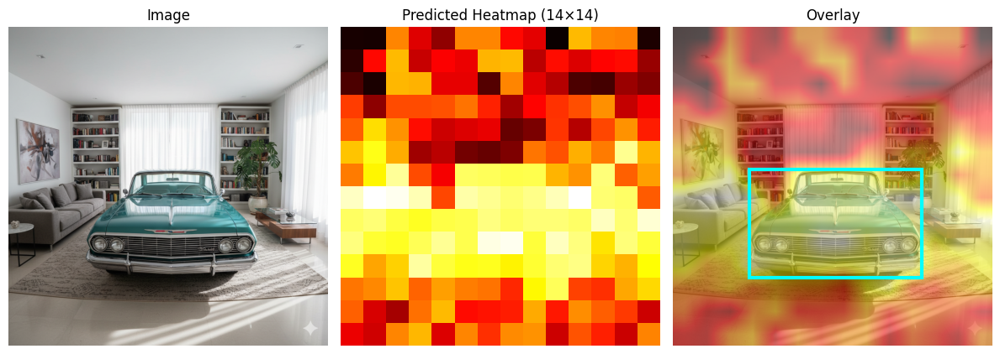

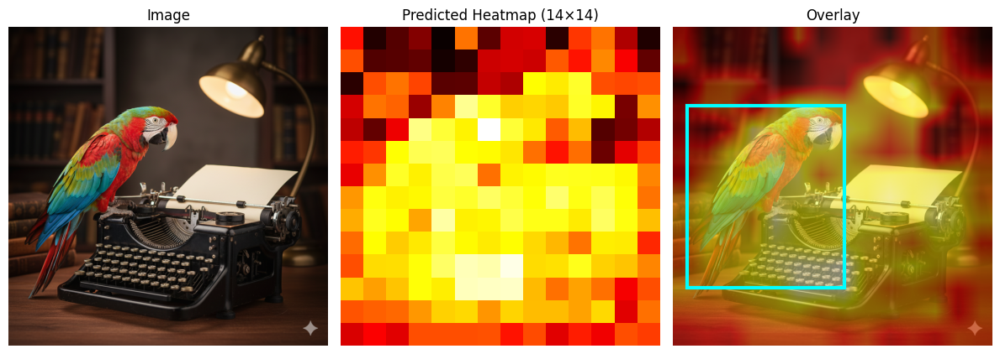

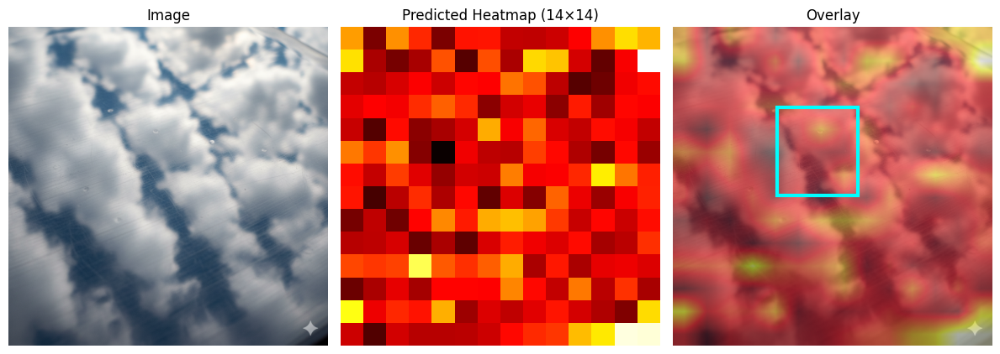

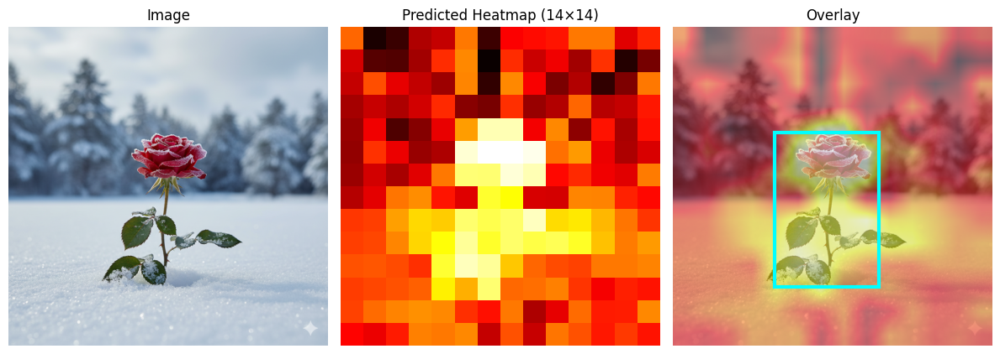

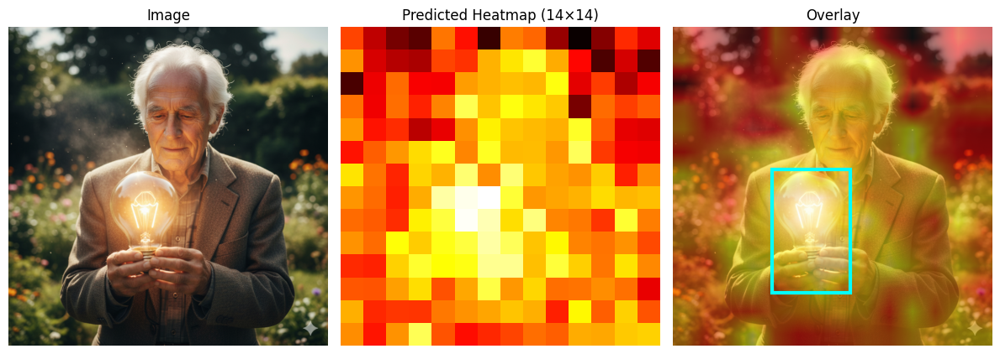

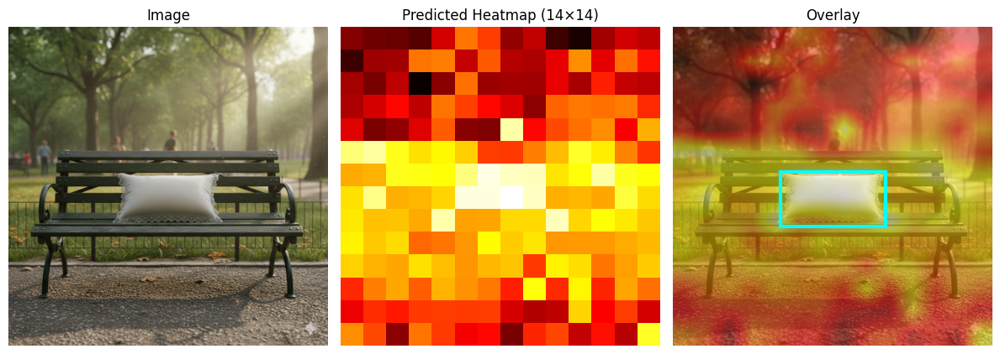

Validating & Saving (inference-only):  12%|█▎        | 1/8 [00:23<02:41, 23.14s/it]

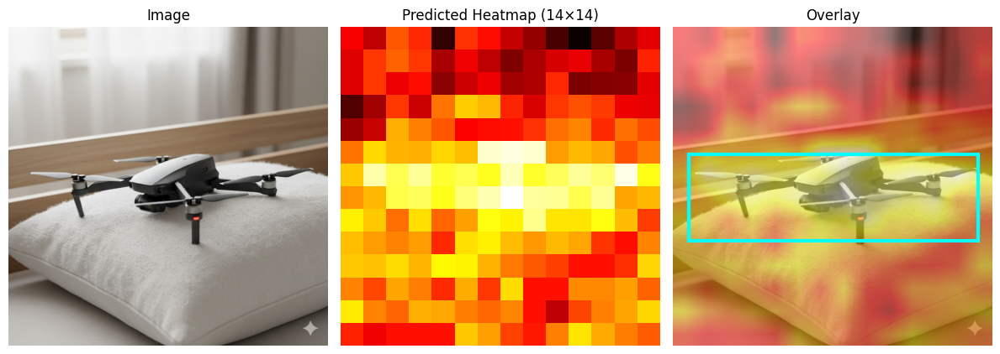

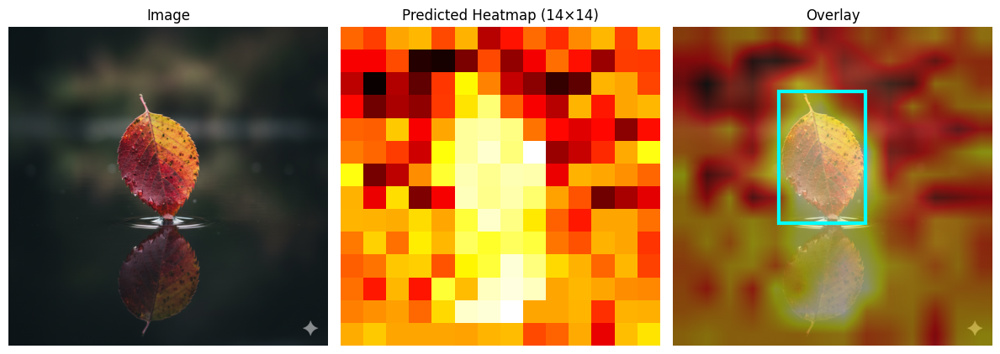

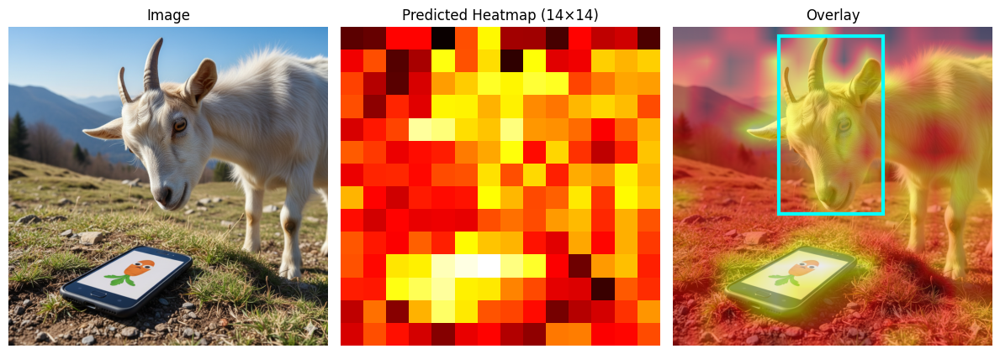

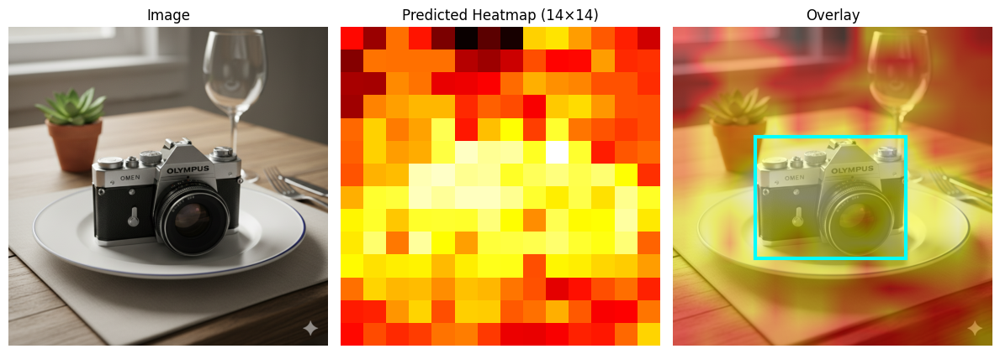

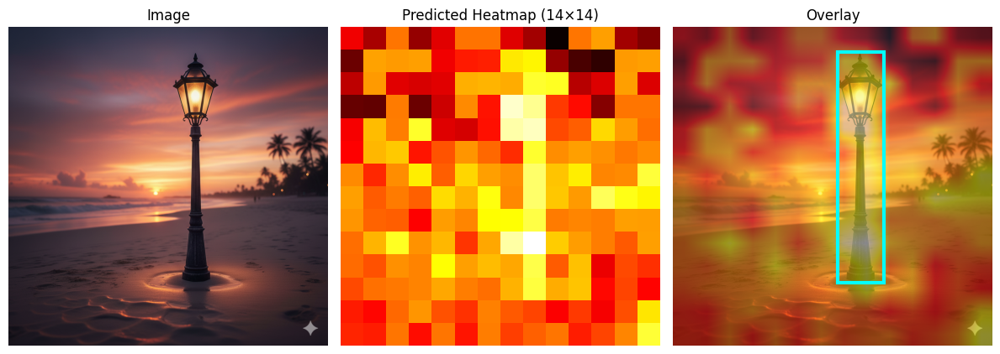

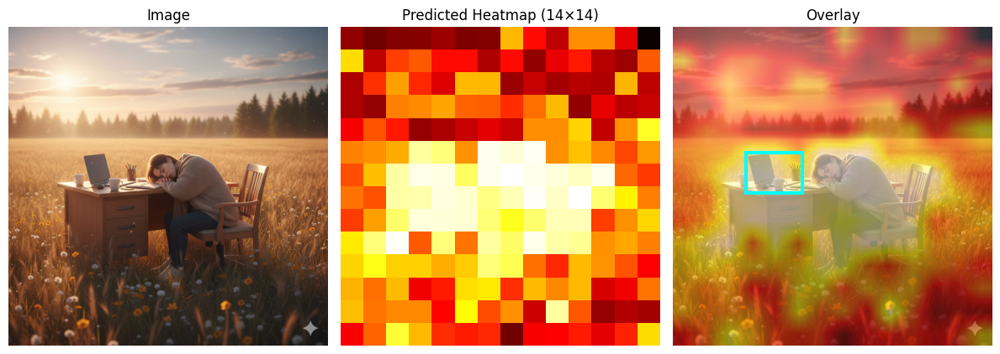

Validating & Saving (inference-only):  25%|██▌       | 2/8 [00:41<02:02, 20.44s/it]

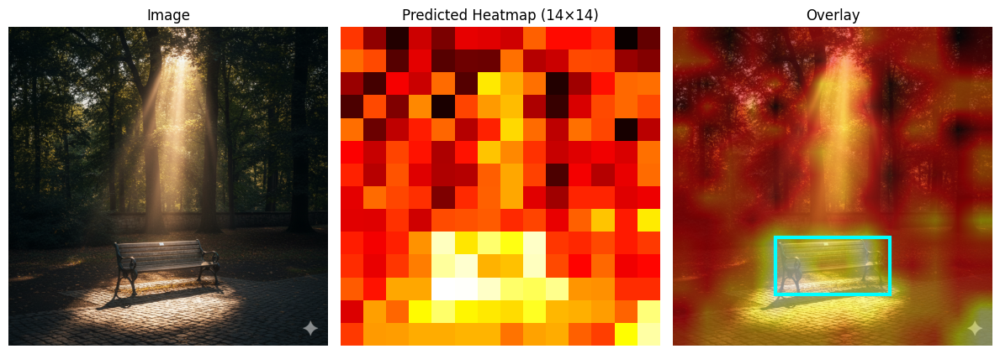

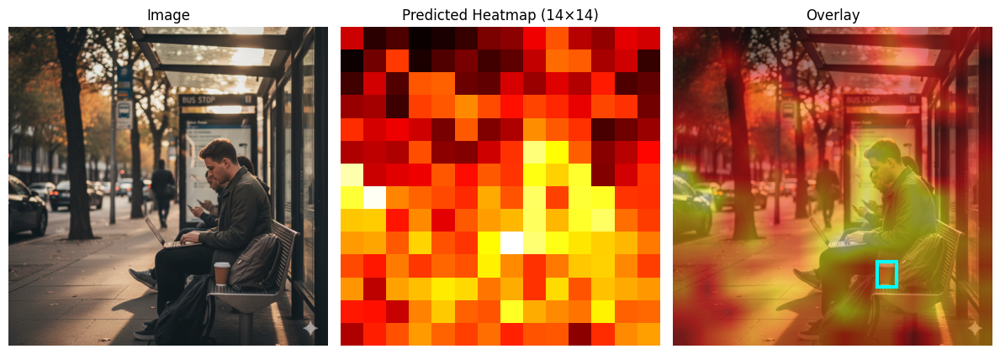

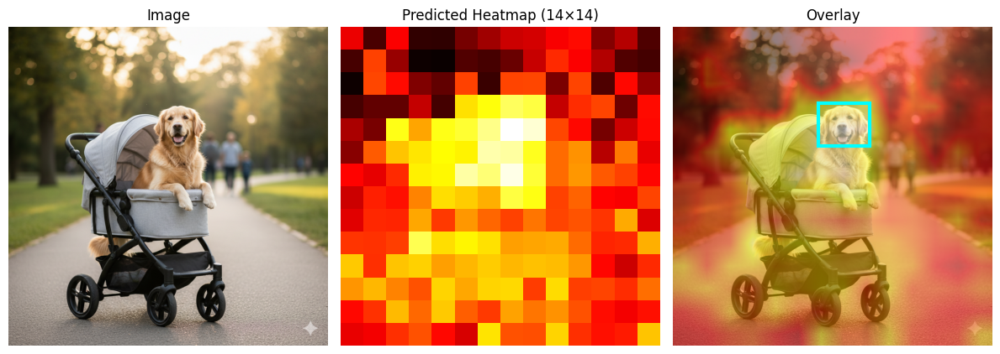

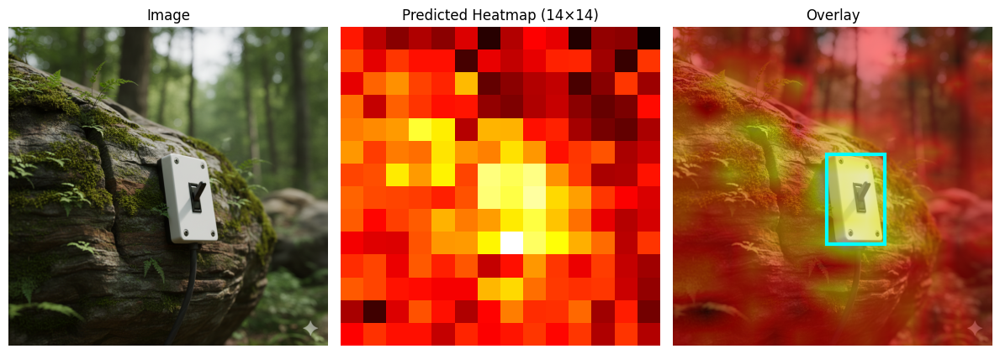

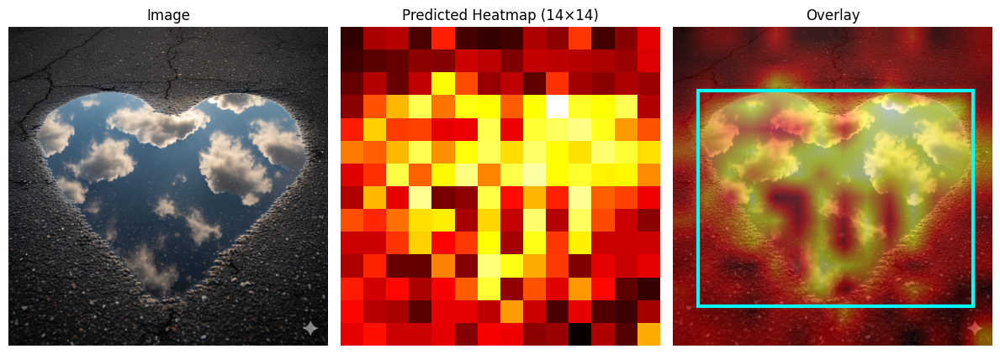

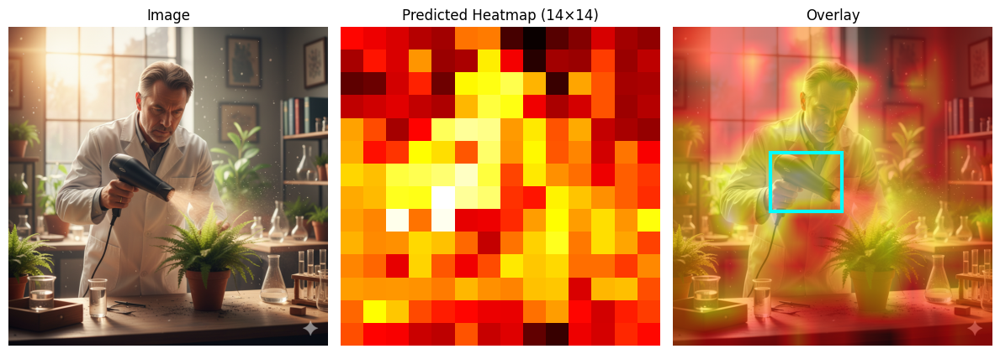

Validating & Saving (inference-only):  38%|███▊      | 3/8 [00:57<01:31, 18.22s/it]

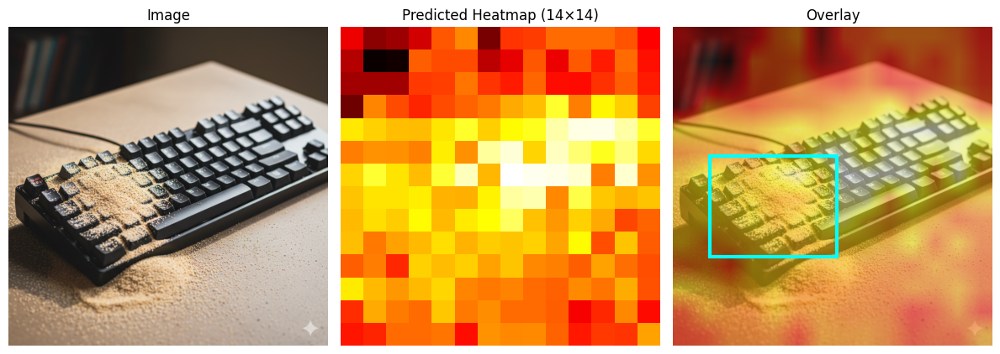

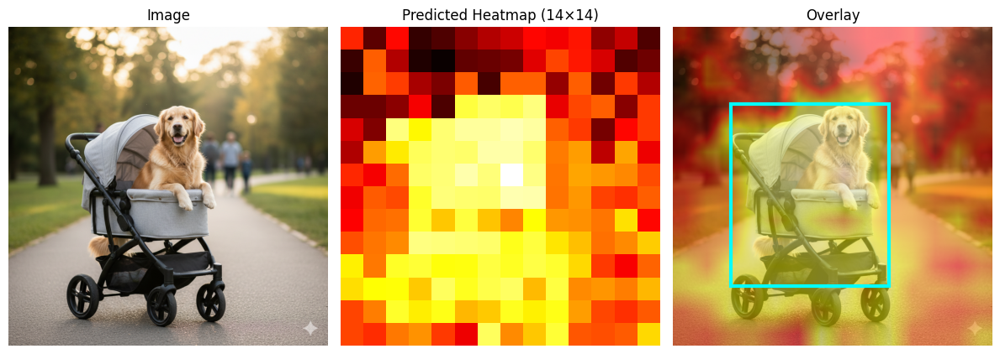

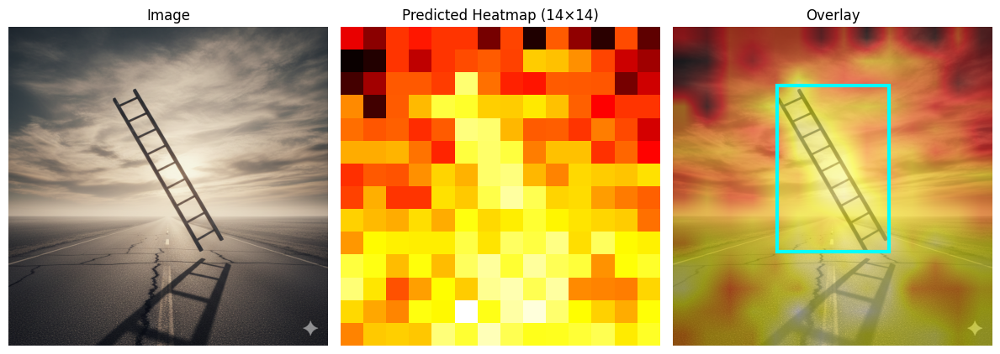

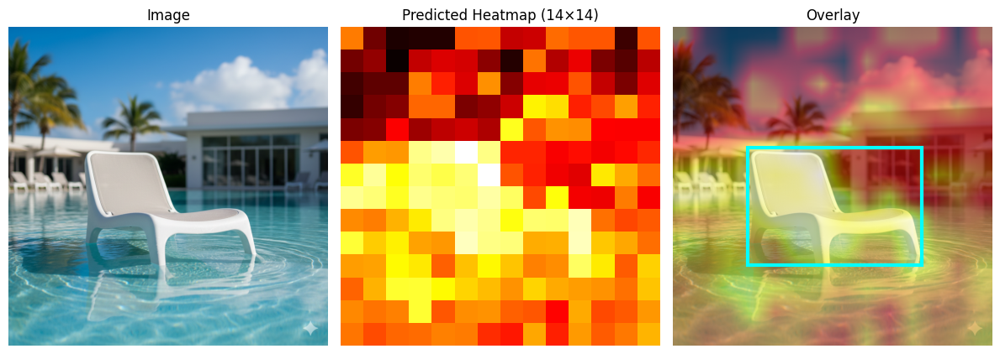

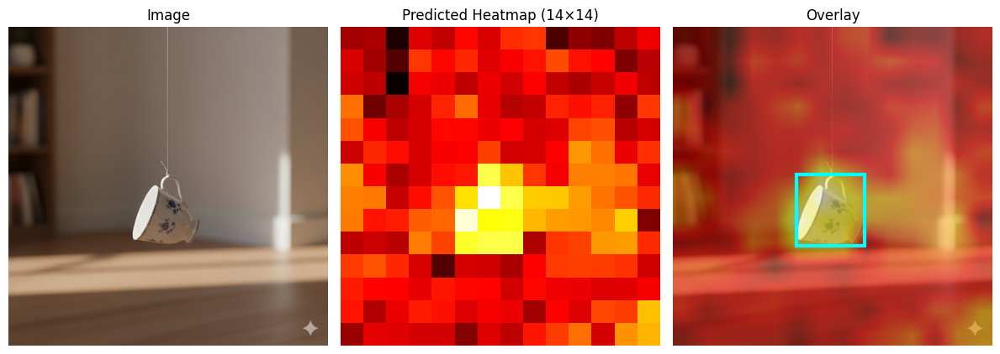

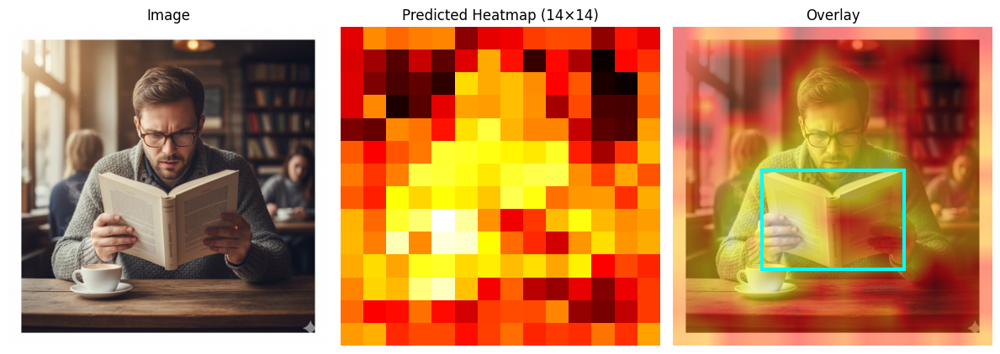

Validating & Saving (inference-only):  50%|█████     | 4/8 [01:07<01:00, 15.14s/it]

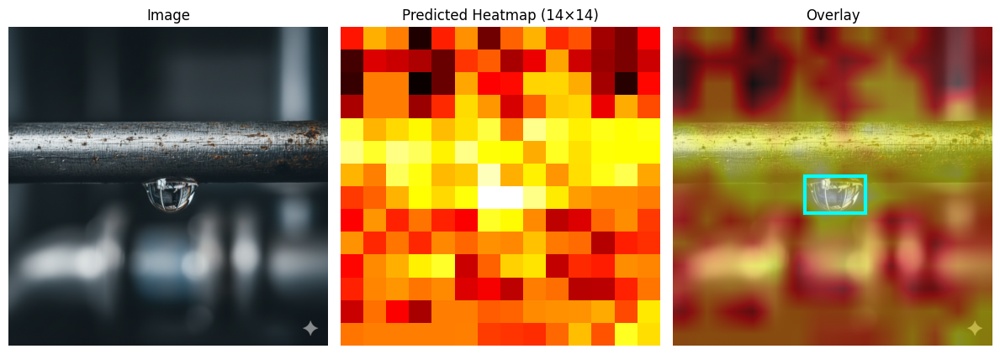

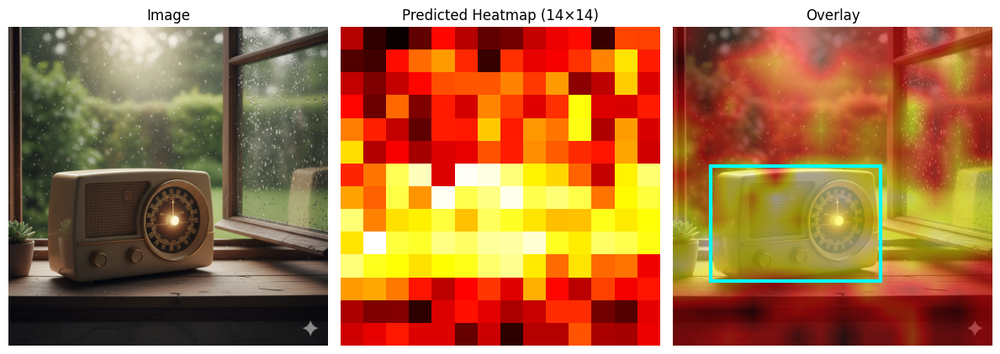

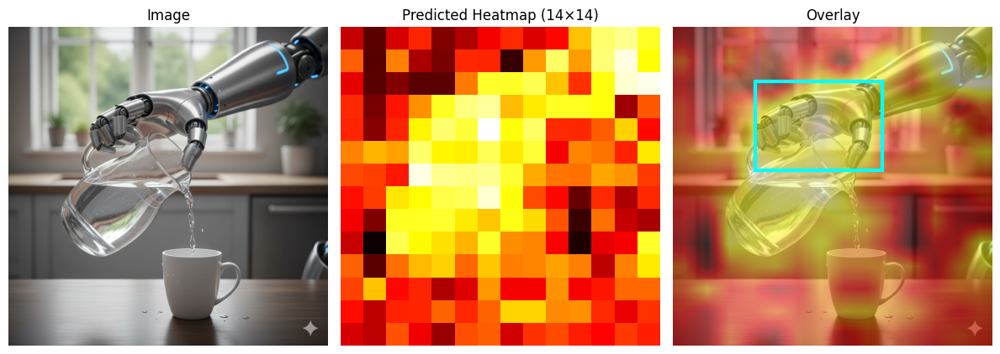

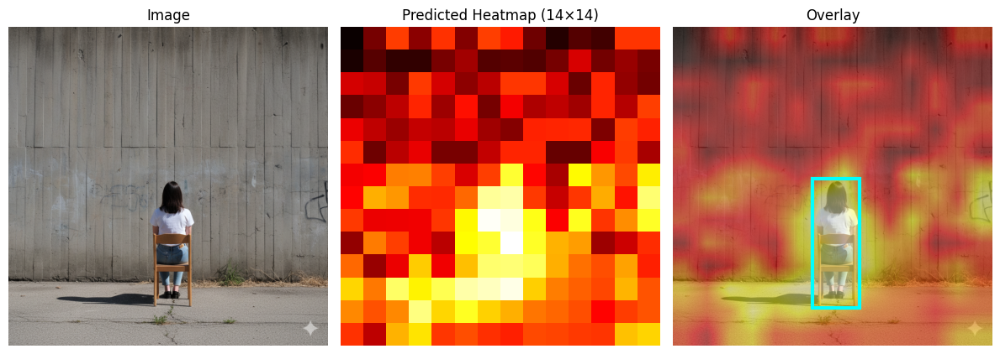

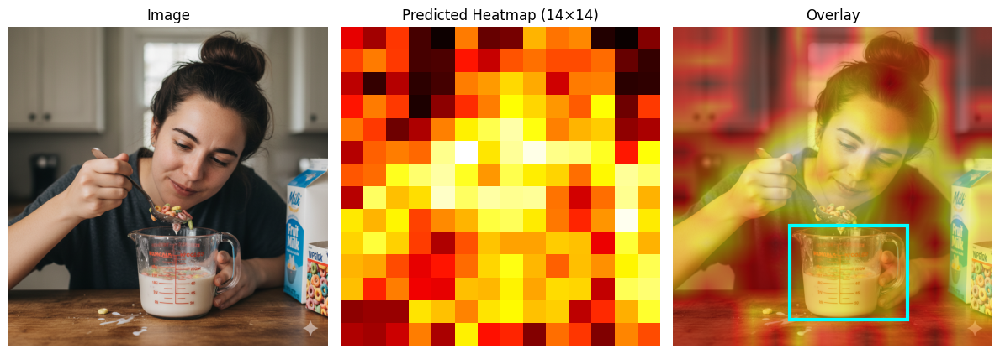

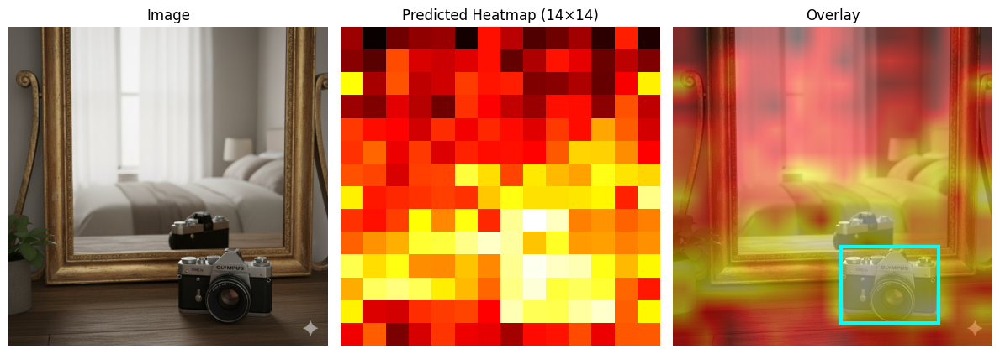

Validating & Saving (inference-only):  62%|██████▎   | 5/8 [01:18<00:40, 13.59s/it]

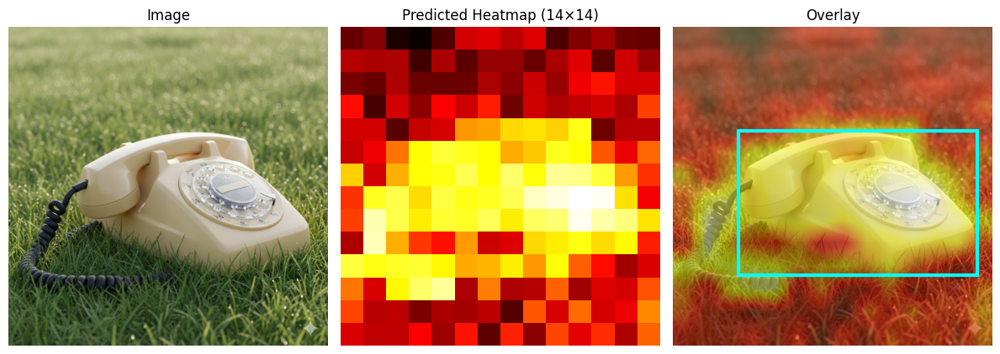

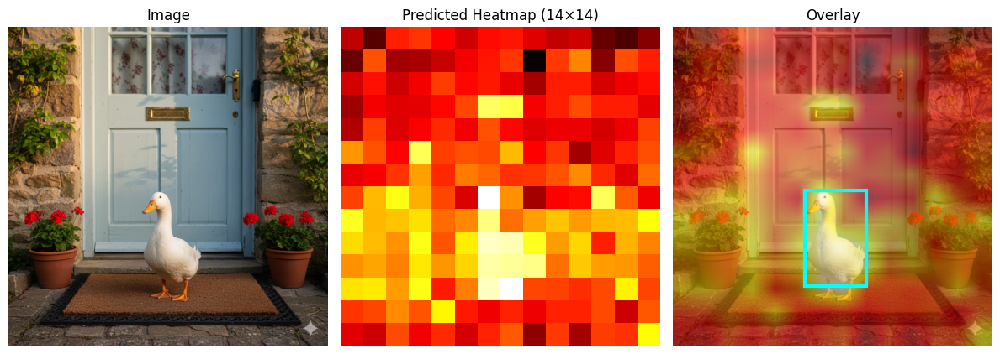

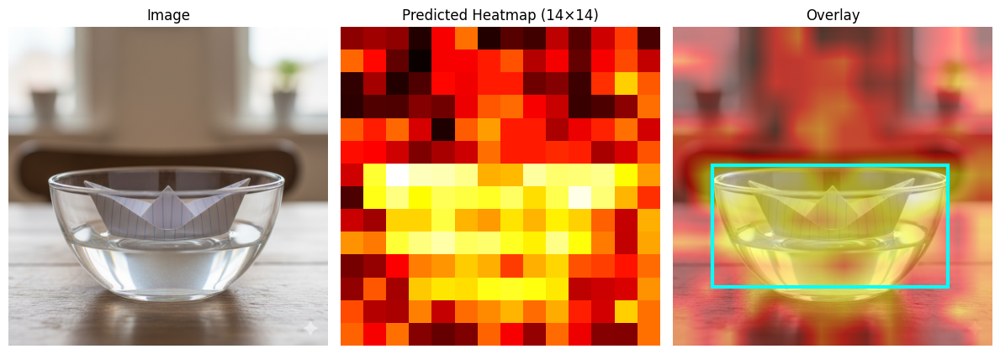

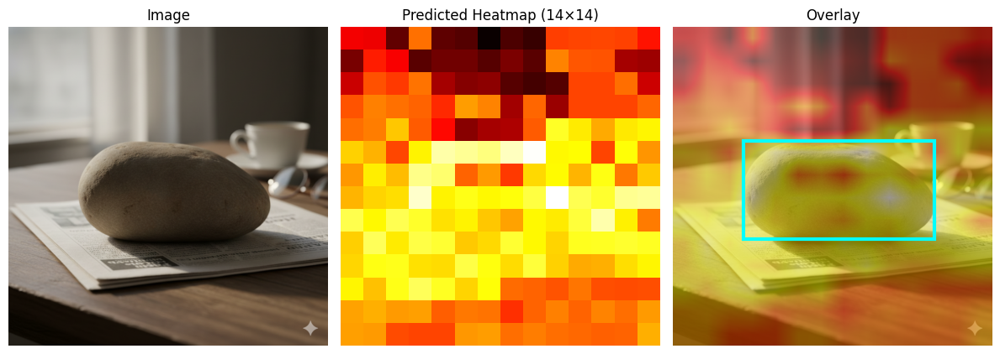

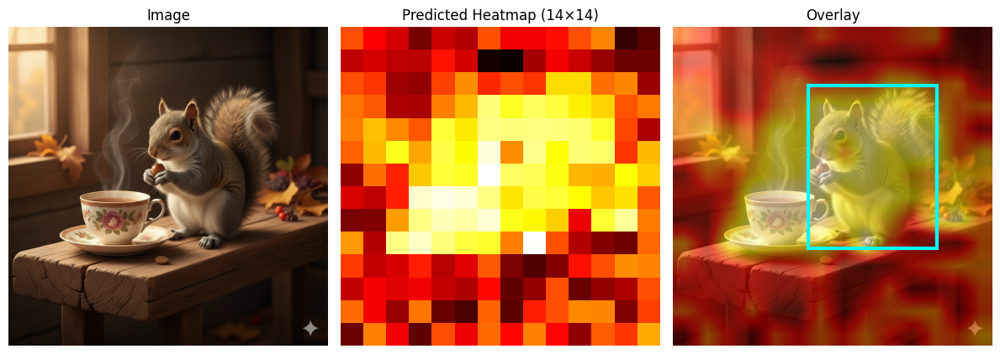

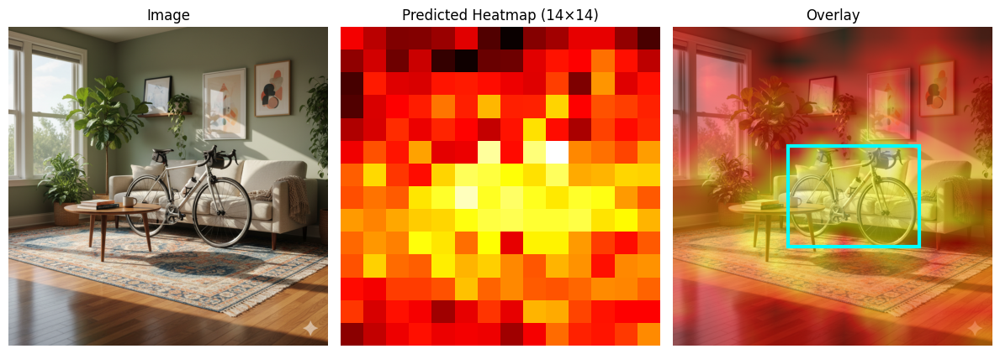

Validating & Saving (inference-only):  75%|███████▌  | 6/8 [01:30<00:26, 13.07s/it]

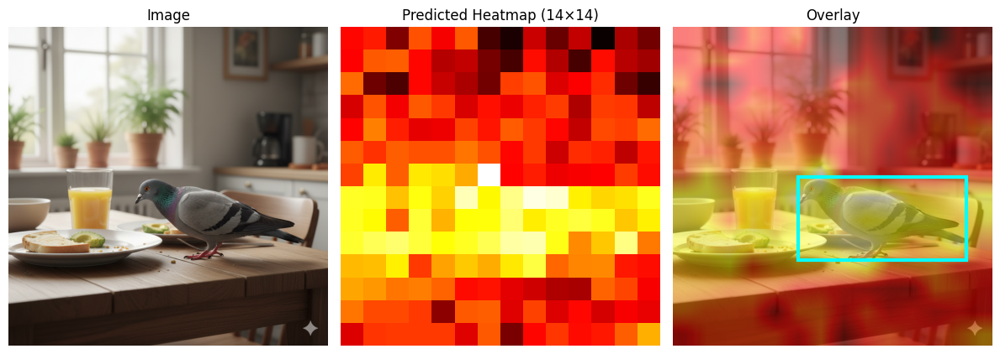

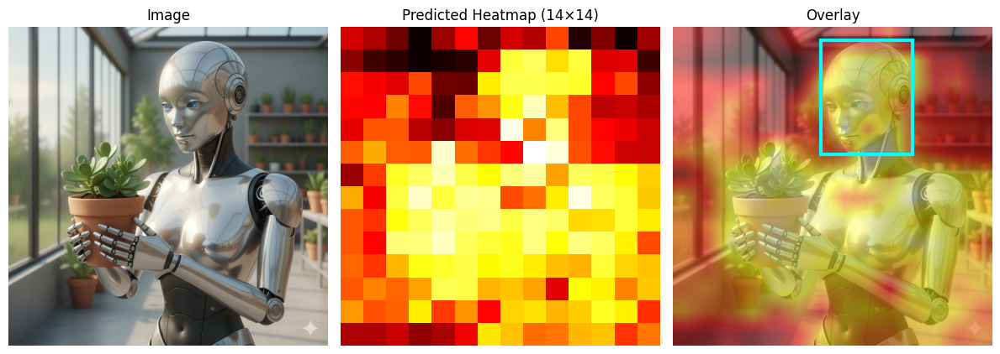

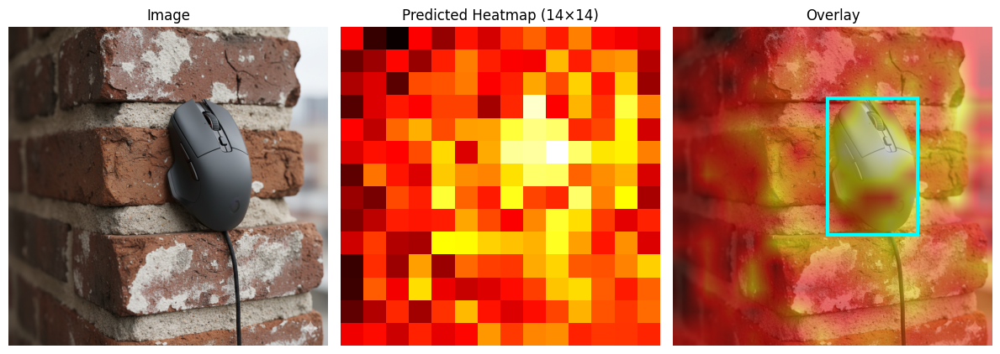

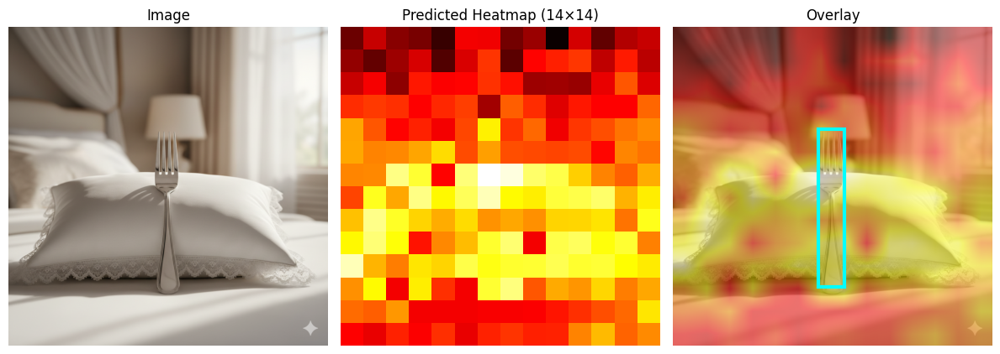

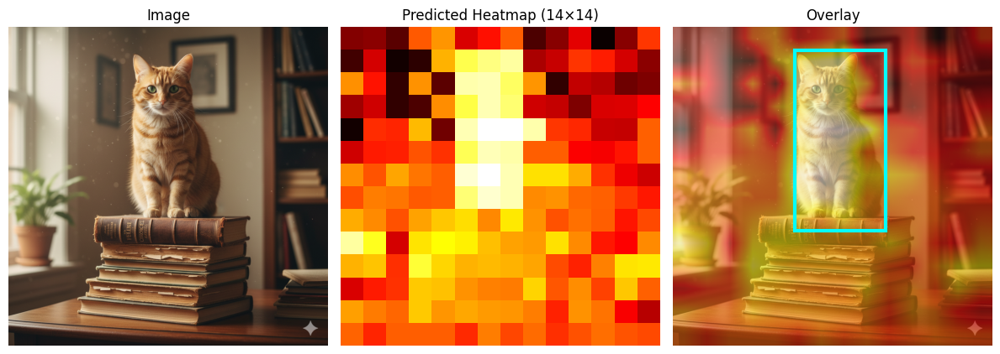

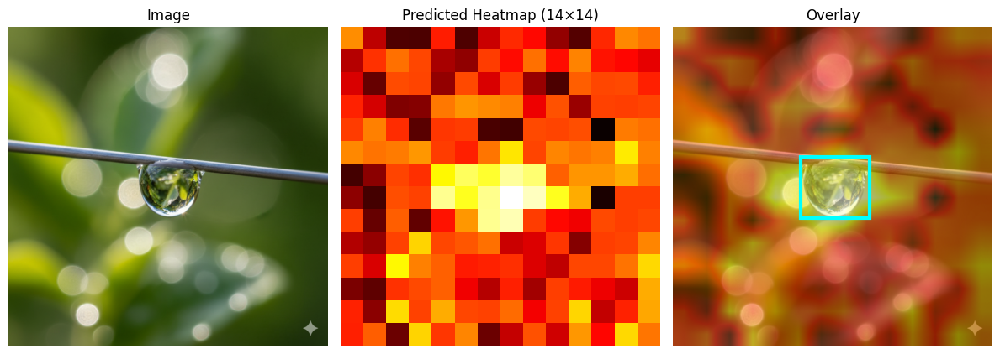

Validating & Saving (inference-only):  88%|████████▊ | 7/8 [01:42<00:12, 12.54s/it]

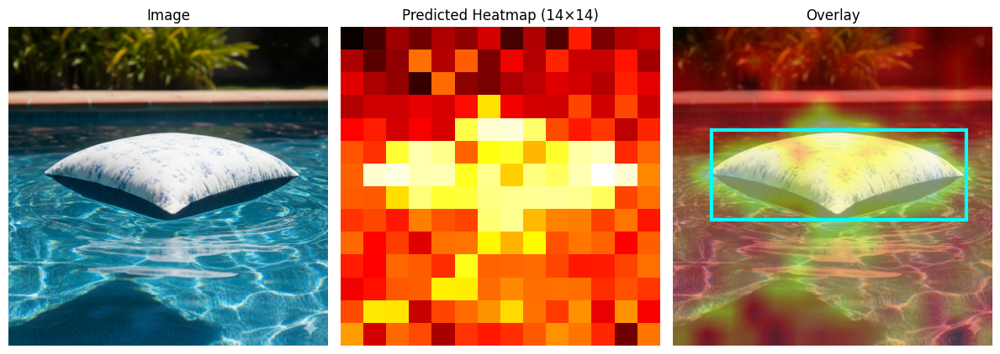

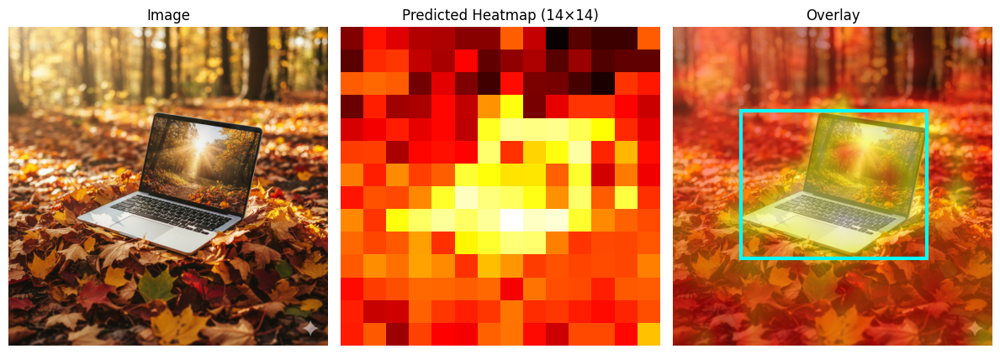

Validating & Saving (inference-only): 100%|██████████| 8/8 [01:45<00:00, 13.25s/it]


Validation summary (inference):
  pearson: 0.4338
  mse: 0.2343
  mae: 0.4386
  iou_top10: 0.2806
  ndcg20: 0.5469

Saved visualizations and metrics to: vqa_curiosity_outputs


In [22]:
# Inference-only validation: load saved model and evaluate (no training)

# Instantiate and load checkpoint
ckpt_path = "vqa_curiosity_best.pth"
model_infer = VQACuriosityNet(freeze_vision=True, freeze_text=True).to(device)
state = torch.load(ckpt_path, map_location=device)
state_dict = state.get("model_state_dict", state)
model_infer.load_state_dict(state_dict, strict=False)
print("Loaded checkpoint:", ckpt_path)

# Run evaluation
outputs_dir = Path("vqa_curiosity_outputs")
outputs_dir.mkdir(exist_ok=True)

metrics = {"pearson": [], "mse": [], "mae": [], "iou_top10": [], "ndcg20": []}

model_infer.eval()
with torch.no_grad():
    for i, batch in enumerate(tqdm(val_loader, desc="Validating & Saving (inference-only)")):
        images = batch["image"].to(device)
        input_ids = batch["input_ids"].to(device)
        attention_mask = batch["attention_mask"].to(device)
        targets_t = batch["target_map"].to(device)
        masks_t = batch["patch_mask"].to(device)
        qtypes = batch["question_type"]

        preds_t = model_infer(images, input_ids, attention_mask, qtypes)

        for b in range(images.size(0)):
            pred = preds_t[b].cpu().numpy()
            tgt = targets_t[b].cpu().numpy()
            mask = masks_t[b].cpu().numpy() > 0.5

            # Normalize
            p_min, p_max = pred.min(), pred.max(); pred_n = (pred - p_min) / (p_max - p_min + 1e-8)
            t_min, t_max = tgt.min(), tgt.max(); tgt_n = (tgt - t_min) / (t_max - t_min + 1e-8)

            # Metrics
            metrics["pearson"].append(pearson_corr(pred_n, tgt_n))
            metrics["mse"].append(mse(pred_n, tgt_n))
            metrics["mae"].append(mae(pred_n, tgt_n))
            pred_mask = topk_mask_from_heatmap(pred_n, k_frac=0.1)
            gt_mask = mask
            metrics["iou_top10"].append(iou_from_masks(pred_mask, gt_mask))
            metrics["ndcg20"].append(ndcg_at_k(pred_n, tgt_n, k=20))

            # Save viz
            save_path = outputs_dir / f"val_{i:03d}_{b:02d}.png"
            bbox_src = batch["bbox_original"]
            if isinstance(bbox_src, dict):
                bbox_vis = {
                    "xtl": int(bbox_src["xtl"][b]),
                    "ytl": int(bbox_src["ytl"][b]),
                    "xbr": int(bbox_src["xbr"][b]),
                    "ybr": int(bbox_src["ybr"][b]),
                }
            else:
                bbox_vis = bbox_src[b]
            visualize_overlay(batch["image_path"][b], pred, bbox_vis, save_path=str(save_path))

# Save summary
summary = {k: float(np.mean(v)) if len(v) else 0.0 for k, v in metrics.items()}
with open(outputs_dir / "metrics.json", "w") as f:
    json.dump({"summary": summary, "all": metrics}, f, indent=2)

print("\nValidation summary (inference):")
for k, v in summary.items():
    print(f"  {k}: {v:.4f}")
print(f"\nSaved visualizations and metrics to: {outputs_dir}")
